In [ ]:
'''
Code Adapted from https://github.com/Hvass-Labs/TensorFlow-Tutorials/blob/master/14_DeepDream.ipynb

The MIT License (MIT)

Copyright (c) 2016 by Magnus Erik Hvass Pedersen

'''

In [27]:
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
import random
import math

# Image manipulation.
import PIL.Image
from scipy.ndimage.filters import gaussian_filter

In [28]:
import inception5h

In [29]:
model = inception5h.Inception5h()

In [30]:
len(model.layer_tensors)

12

In [31]:
def load_image(filename):
    image = PIL.Image.open(filename)

    return np.float32(image)

In [32]:
def save_image(image, filename):
    # Ensure the pixel-values are between 0 and 255.
    image = np.clip(image, 0.0, 255.0)
    
    # Convert to bytes.
    image = image.astype(np.uint8)
    
    # Write the image-file in jpeg-format.
    with open(filename, 'wb') as file:
        PIL.Image.fromarray(image).save(file, 'jpeg')

In [33]:
def plot_image(image):
    # Assume the pixel-values are scaled between 0 and 255.
    
    if False:
        # Convert the pixel-values to the range between 0.0 and 1.0
        image = np.clip(image/255.0, 0.0, 1.0)
        
        # Plot using matplotlib.
        plt.imshow(image, interpolation='lanczos')
        plt.show()
    else:
        # Ensure the pixel-values are between 0 and 255.
        image = np.clip(image, 0.0, 255.0)
        
        # Convert pixels to bytes.
        image = image.astype(np.uint8)

        # Convert to a PIL-image and display it.
        display(PIL.Image.fromarray(image))

In [34]:
def normalize_image(x):
    # Get the min and max values for all pixels in the input.
    x_min = x.min()
    x_max = x.max()

    # Normalize so all values are between 0.0 and 1.0
    x_norm = (x - x_min) / (x_max - x_min)
    
    return x_norm

In [35]:
def plot_gradient(gradient):
    # Normalize the gradient so it is between 0.0 and 1.0
    gradient_normalized = normalize_image(gradient)
    
    # Plot the normalized gradient.
    plt.imshow(gradient_normalized, interpolation='bilinear')
    plt.show()

In [36]:
def resize_image(image, size=None, factor=None):
    # If a rescaling-factor is provided then use it.
    if factor is not None:
        # Scale the numpy array's shape for height and width.
        size = np.array(image.shape[0:2]) * factor
        
        # The size is floating-point because it was scaled.
        # PIL requires the size to be integers.
        size = size.astype(int)
    else:
        # Ensure the size has length 2.
        size = size[0:2]
    
    # The height and width is reversed in numpy vs. PIL.
    size = tuple(reversed(size))

    # Ensure the pixel-values are between 0 and 255.
    img = np.clip(image, 0.0, 255.0)
    
    # Convert the pixels to 8-bit bytes.
    img = img.astype(np.uint8)
    
    # Create PIL-object from numpy array.
    img = PIL.Image.fromarray(img)
    
    # Resize the image.
    img_resized = img.resize(size, PIL.Image.LANCZOS)
    
    # Convert 8-bit pixel values back to floating-point.
    img_resized = np.float32(img_resized)

    return img_resized

In [37]:
def get_tile_size(num_pixels, tile_size=400):
    """
    num_pixels is the number of pixels in a dimension of the image.
    tile_size is the desired tile-size.
    """

    # How many times can we repeat a tile of the desired size.
    num_tiles = int(round(num_pixels / tile_size))
    
    # Ensure that there is at least 1 tile.
    num_tiles = max(1, num_tiles)
    
    # The actual tile-size.
    actual_tile_size = math.ceil(num_pixels / num_tiles)
    
    return actual_tile_size

In [38]:
def tiled_gradient(gradient, image, tile_size=400):
    # Allocate an array for the gradient of the entire image.
    grad = np.zeros_like(image)

    # Number of pixels for the x- and y-axes.
    x_max, y_max, _ = image.shape

    # Tile-size for the x-axis.
    x_tile_size = get_tile_size(num_pixels=x_max, tile_size=tile_size)
    # 1/4 of the tile-size.
    x_tile_size4 = x_tile_size // 4

    # Tile-size for the y-axis.
    y_tile_size = get_tile_size(num_pixels=y_max, tile_size=tile_size)
    # 1/4 of the tile-size
    y_tile_size4 = y_tile_size // 4

    x_start = random.randint(-3*x_tile_size4, -x_tile_size4)

    while x_start < x_max:

        x_end = x_start + x_tile_size
        x_start_lim = max(x_start, 0)
        x_end_lim = min(x_end, x_max)
        y_start = random.randint(-3*y_tile_size4, -y_tile_size4)

        while y_start < y_max:

            y_end = y_start + y_tile_size
            y_start_lim = max(y_start, 0)
            y_end_lim = min(y_end, y_max)

            img_tile = image[x_start_lim:x_end_lim,
                             y_start_lim:y_end_lim, :]

            feed_dict = model.create_feed_dict(image=img_tile)

            # calculate the gradient-value.
            g = session.run(gradient, feed_dict=feed_dict)

            # Normalize the gradient for the tile
            g /= (np.std(g) + 1e-8)

            grad[x_start_lim:x_end_lim,
                 y_start_lim:y_end_lim, :] = g
            
            # Advance the start-position for the y-axis.
            y_start = y_end

        # Advance the start-position for the x-axis.
        x_start = x_end

    return grad

In [39]:
def optimize_image(layer_tensor, image,
                   num_iterations=10, step_size=3.0, tile_size=400,
                   show_gradient=False):

    # Copy the image 
    img = image.copy()
    
    print("Image before:")
    plot_image(img)

    print("Processing image: ", end="")
    gradient = model.get_gradient(layer_tensor)
    
    for i in range(num_iterations):
        grad = tiled_gradient(gradient=gradient, image=img,
                              tile_size=tile_size)
        
        sigma = (i * 4.0) / num_iterations + 0.5
        grad_smooth1 = gaussian_filter(grad, sigma=sigma)
        grad_smooth2 = gaussian_filter(grad, sigma=sigma*2)
        grad_smooth3 = gaussian_filter(grad, sigma=sigma*0.5)
        grad = (grad_smooth1 + grad_smooth2 + grad_smooth3)

        step_size_scaled = step_size / (np.std(grad) + 1e-8)

        img += grad * step_size_scaled
        
        if show_gradient:
            msg = "Gradient min: {0:>9.6f}, max: {1:>9.6f}, stepsize: {2:>9.2f}"
            print(msg.format(grad.min(), grad.max(), step_size_scaled))

            # Plot the gradient.
            plot_gradient(grad)
        else:
            # Otherwise show a little progress-indicator.
            print(". ", end="")

    print()
    print("Image after:")
    plot_image(img)
    
    return img

In [40]:
def recursive_optimize(layer_tensor, image,
                       num_repeats=4, rescale_factor=0.7, blend=0.2,
                       num_iterations=10, step_size=3.0,
                       tile_size=400):

    if num_repeats>0:
        sigma = 0.5
        img_blur = gaussian_filter(image, sigma=(sigma, sigma, 0.0))
        img_downscaled = resize_image(image=img_blur,
                                      factor=rescale_factor)
            
        img_result = recursive_optimize(layer_tensor=layer_tensor,
                                        image=img_downscaled,
                                        num_repeats=num_repeats-1,
                                        rescale_factor=rescale_factor,
                                        blend=blend,
                                        num_iterations=num_iterations,
                                        step_size=step_size,
                                        tile_size=tile_size)
        
        # Upscale the resulting image back to its original size.
        img_upscaled = resize_image(image=img_result, size=image.shape)

        # Blend the original and processed images.
        image = blend * image + (1.0 - blend) * img_upscaled

    print("Recursive level:", num_repeats)

    # Process the image using the DeepDream algorithm.
    img_result = optimize_image(layer_tensor=layer_tensor,
                                image=image,
                                num_iterations=num_iterations,
                                step_size=step_size,
                                tile_size=tile_size)
    
    return img_result

In [41]:
session = tf.InteractiveSession(graph=model.graph)

/Users/gabrielshannon/.local/lib/python3.6/site-packages/tensorflow/python/client/session.py:1702: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


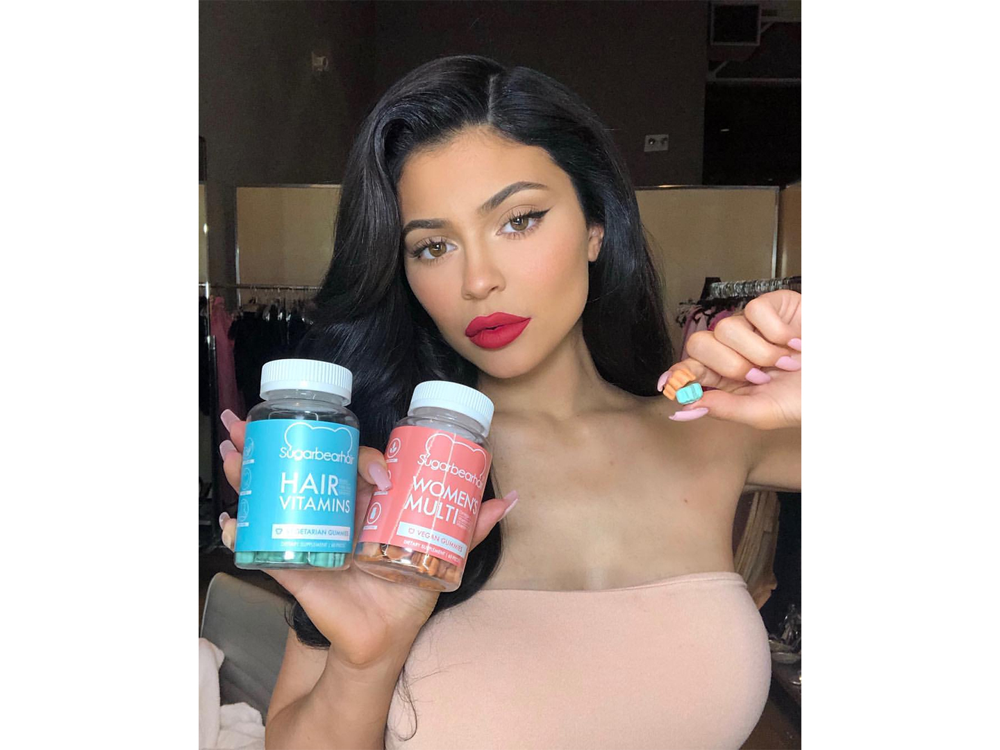

In [42]:
image = load_image(filename='images/hulk.jpg')
plot_image(image)

In [43]:
layer_tensor = model.layer_tensors[2]
layer_tensor

<tf.Tensor 'conv2d2:0' shape=(?, ?, ?, 192) dtype=float32>

Image before:


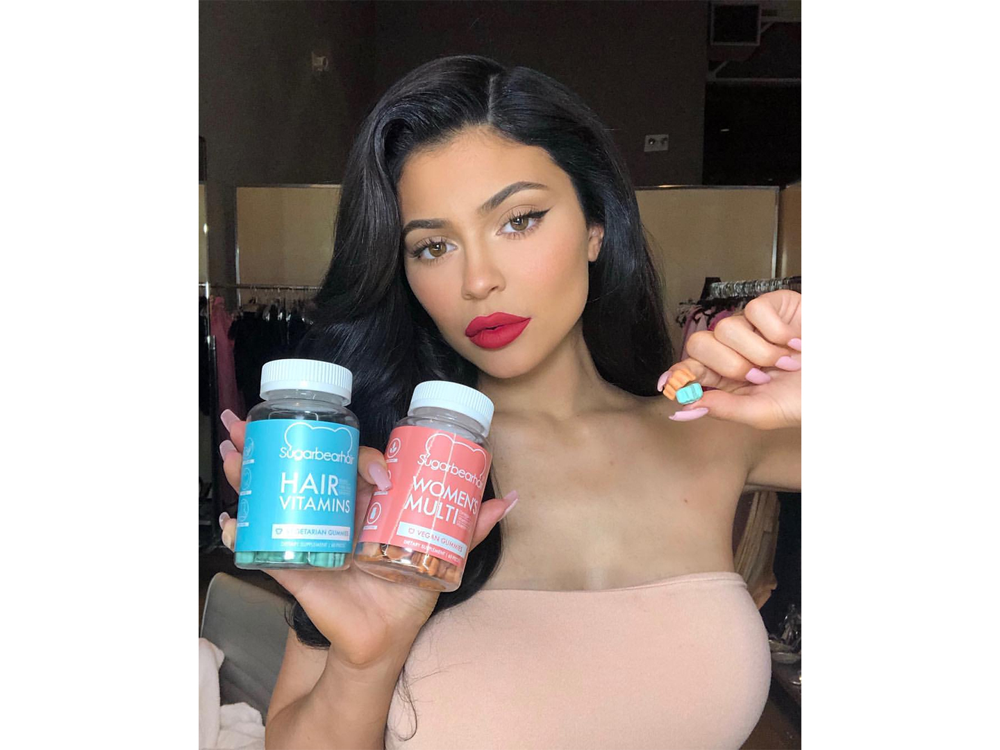

Processing image: Gradient min: -21.856388, max: 30.569550, stepsize:      3.32


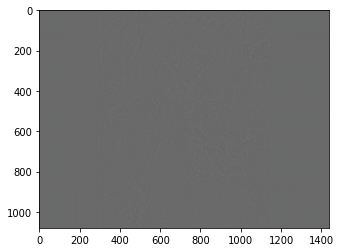

Gradient min: -16.682217, max: 10.898094, stepsize:      6.10


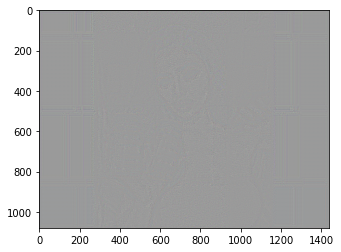

Gradient min: -5.782420, max:  5.256412, stepsize:     11.64


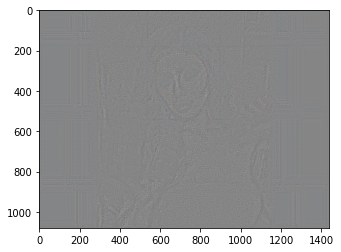

Gradient min: -2.546929, max:  2.916517, stepsize:     18.64


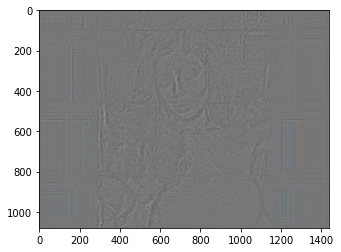

Gradient min: -1.961413, max:  2.451753, stepsize:     26.12


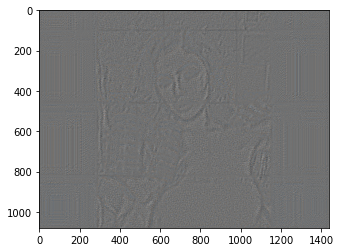

Gradient min: -1.420174, max:  1.301792, stepsize:     33.92


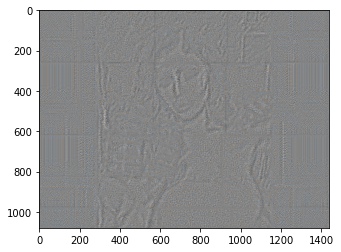

Gradient min: -1.366315, max:  1.070991, stepsize:     43.49


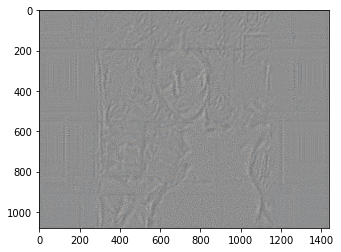

Gradient min: -0.719709, max:  0.745736, stepsize:     53.77


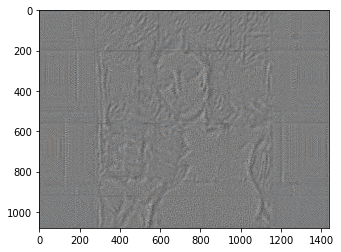

Gradient min: -0.601998, max:  0.575998, stepsize:     69.93


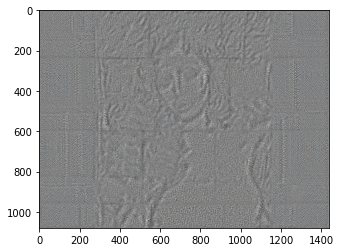

Gradient min: -0.527791, max:  0.504915, stepsize:     86.77


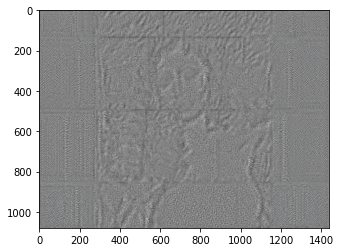


Image after:


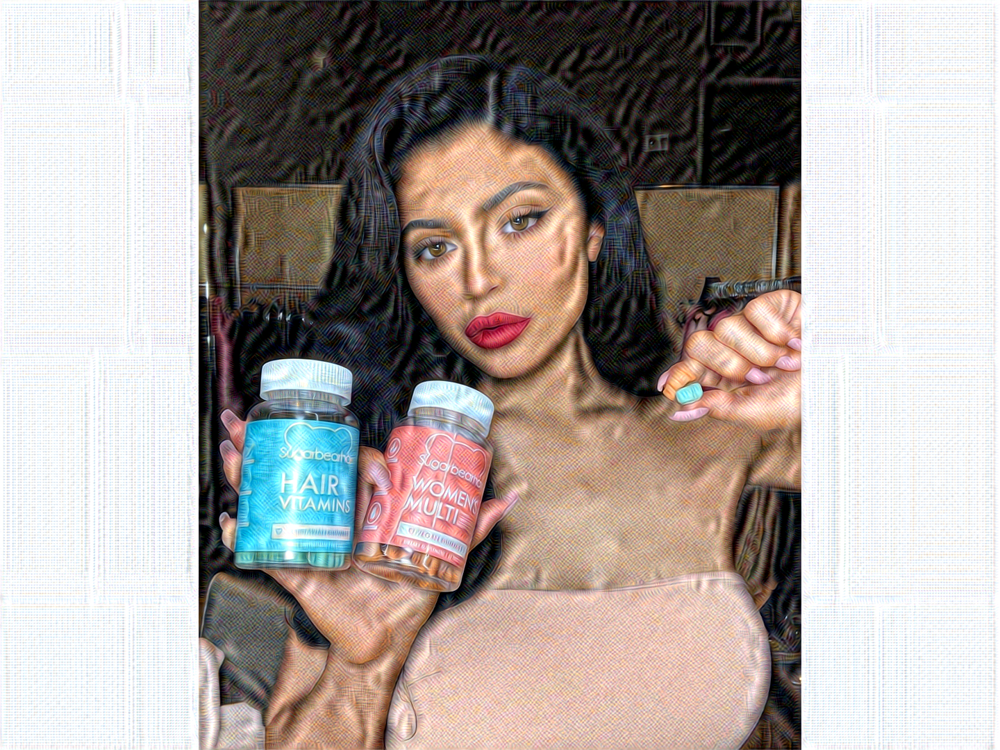

In [44]:
img_result = optimize_image(layer_tensor, image,
                   num_iterations=10, step_size=6.0, tile_size=400,
                   show_gradient=True)

Recursive level: 0
Image before:


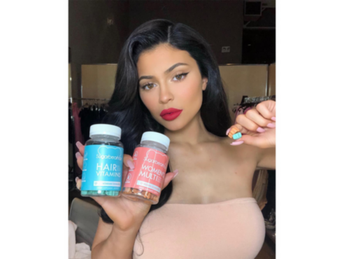

Processing image: . . . . . . . . . . 
Image after:


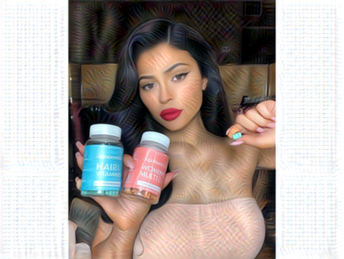

Recursive level: 1
Image before:


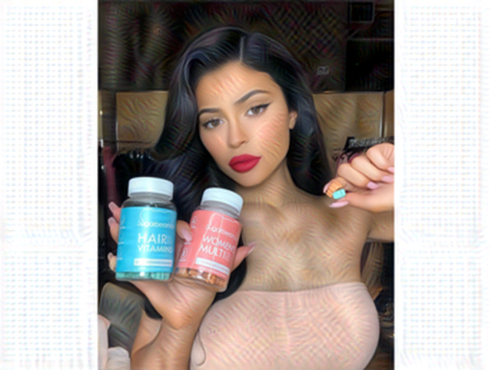

Processing image: . . . . . . . . . . 
Image after:


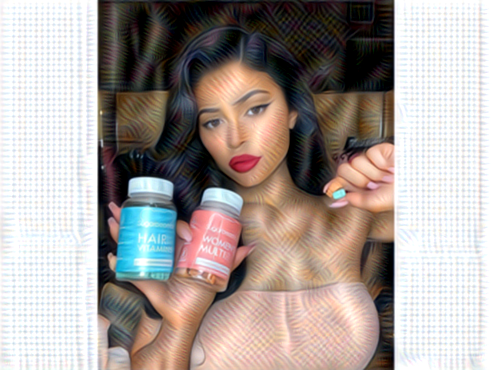

Recursive level: 2
Image before:


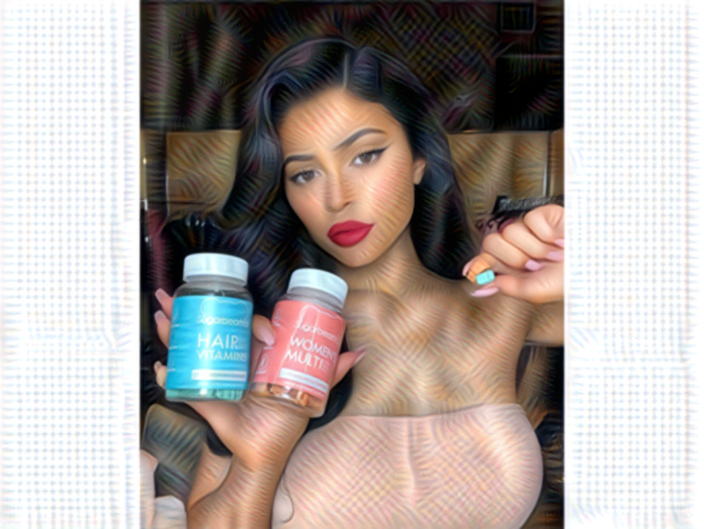

Processing image: . . . . . . . . . . 
Image after:


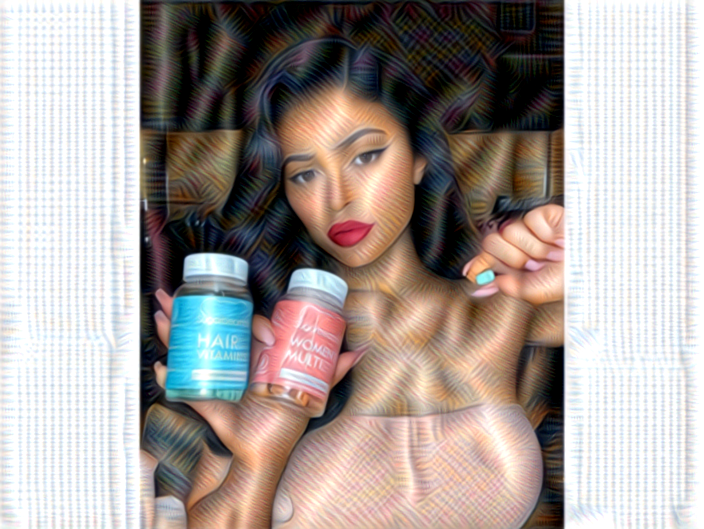

Recursive level: 3
Image before:


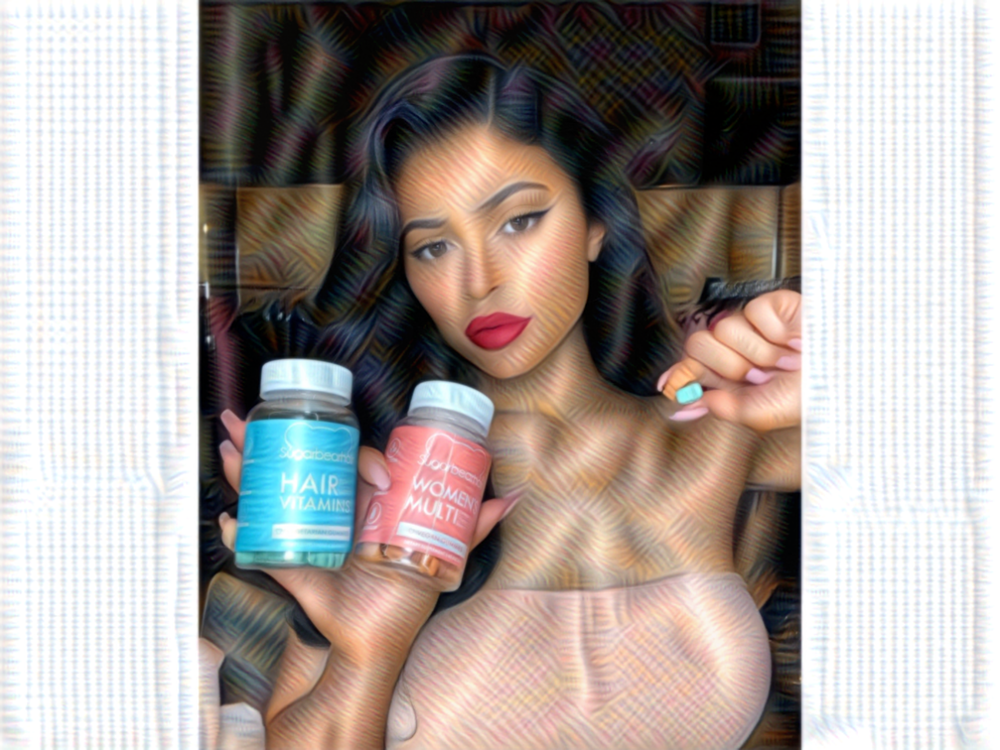

Processing image: . . . . . . . . . . 
Image after:


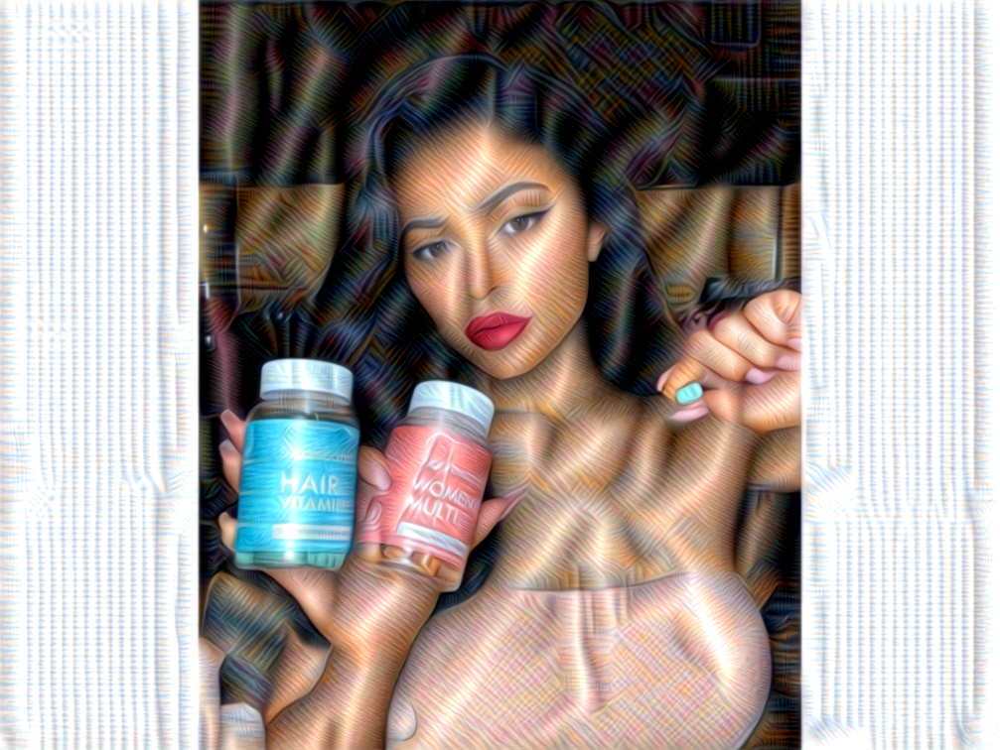

Recursive level: 4
Image before:


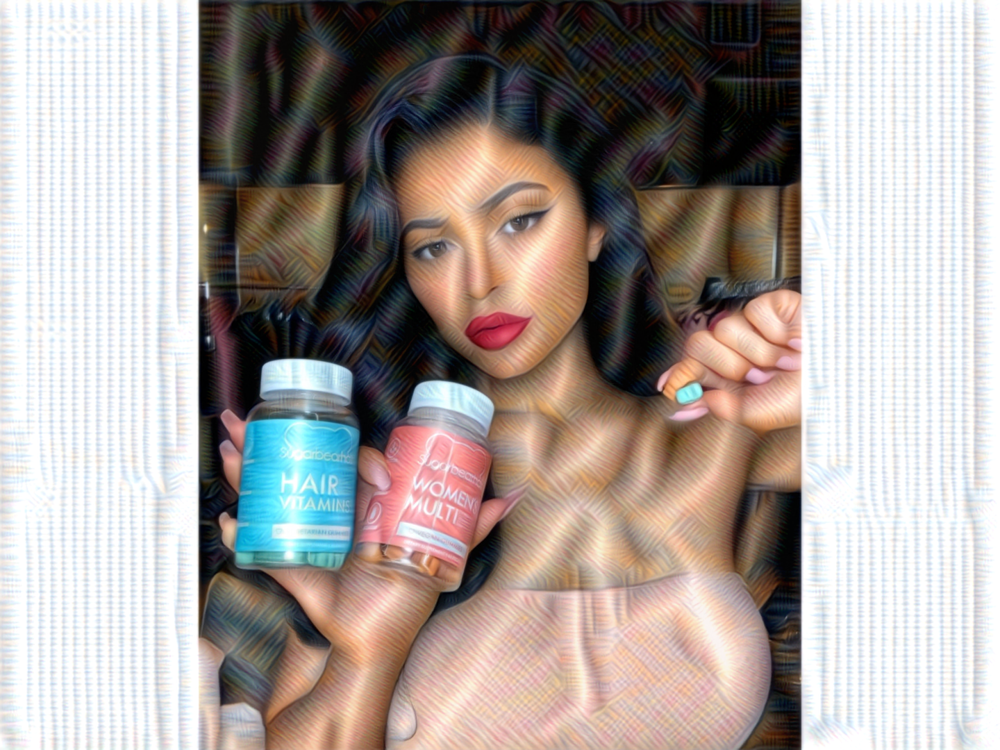

Processing image: . . . . . . . . . . 
Image after:


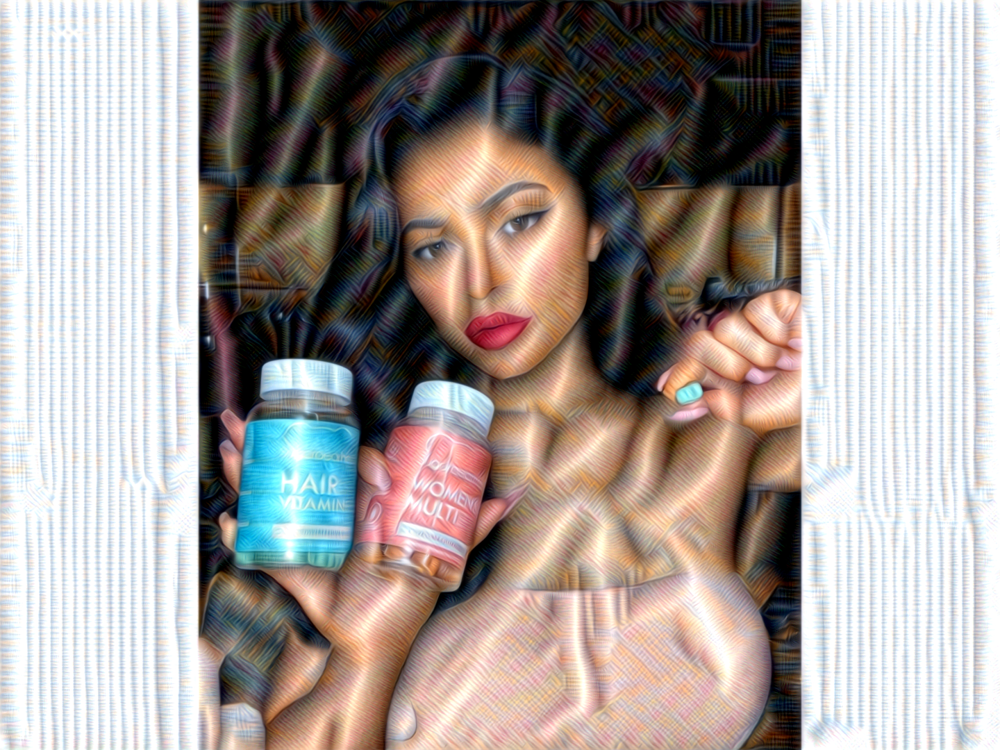

In [45]:
img_result = recursive_optimize(layer_tensor=layer_tensor, image=image,
                 num_iterations=10, step_size=3.0, rescale_factor=0.7,
                 num_repeats=4, blend=0.2)

Recursive level: 0
Image before:


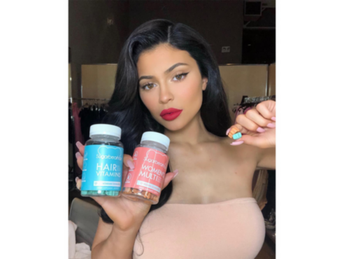

Processing image: . . . . . . . . . . 
Image after:


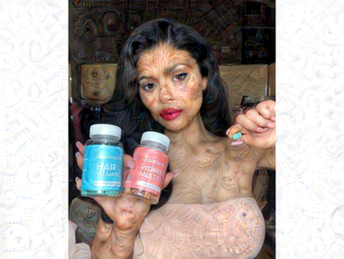

Recursive level: 1
Image before:


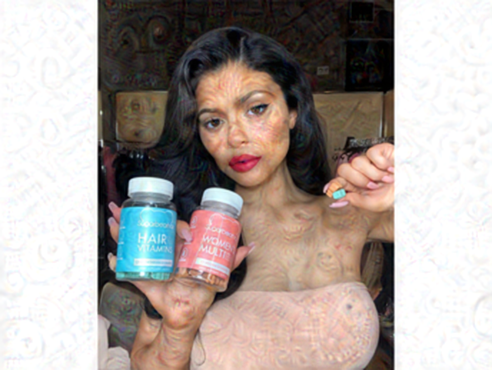

Processing image: . . . . . . . . . . 
Image after:


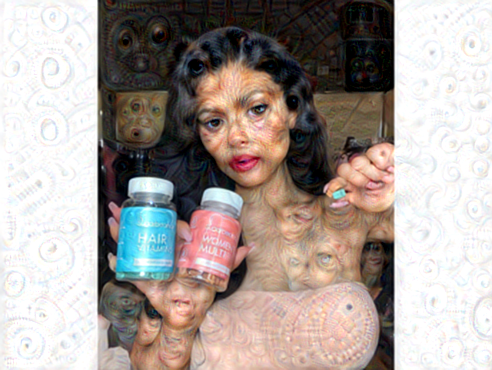

Recursive level: 2
Image before:


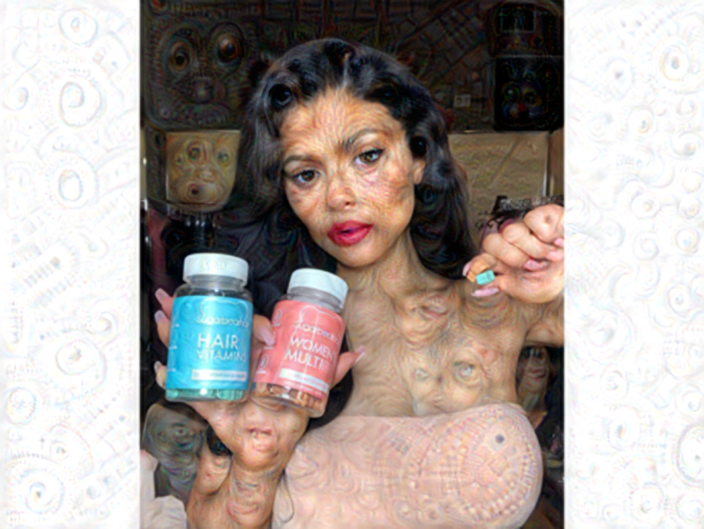

Processing image: . . . . . . . . . . 
Image after:


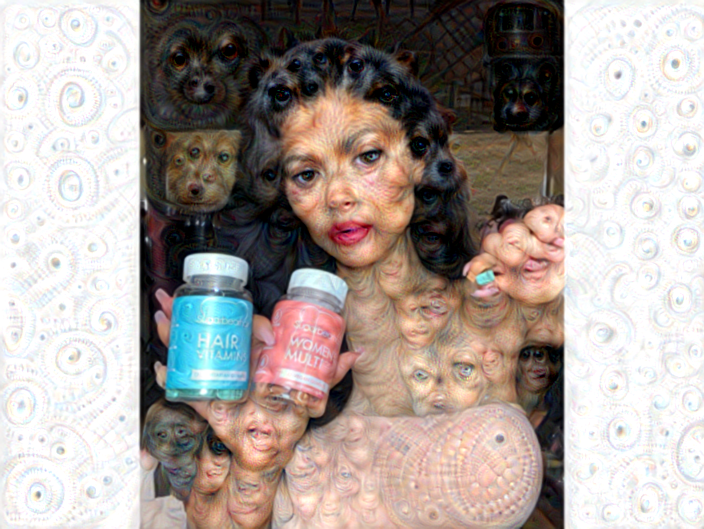

Recursive level: 3
Image before:


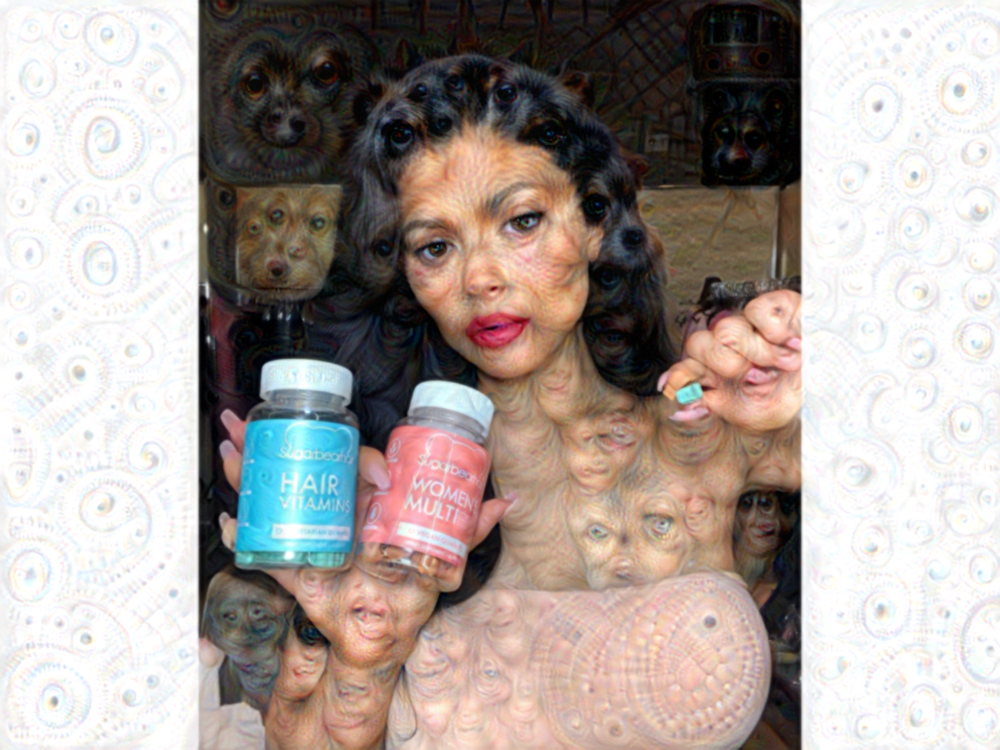

Processing image: . . . . . . . . . . 
Image after:


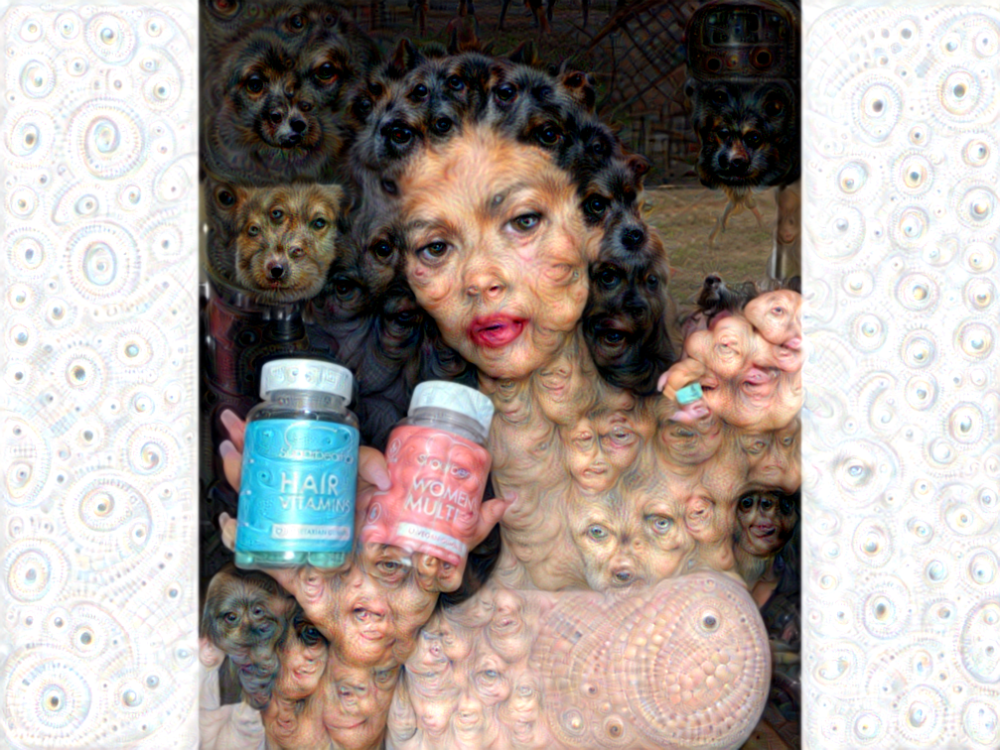

Recursive level: 4
Image before:


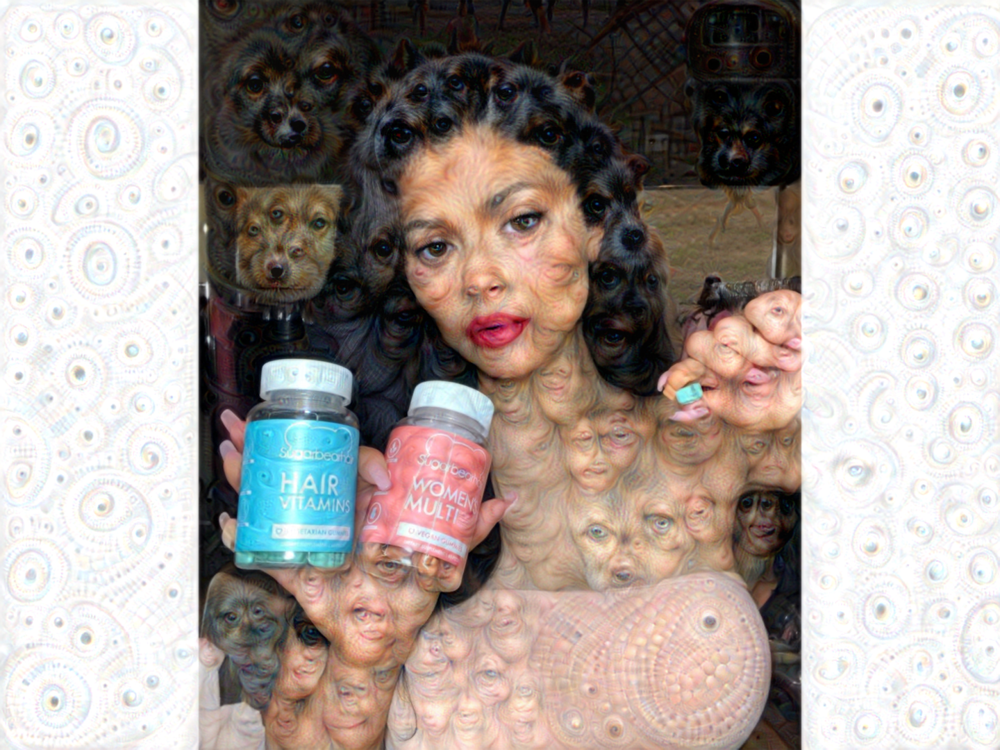

Processing image: . . . . . . . . . . 
Image after:


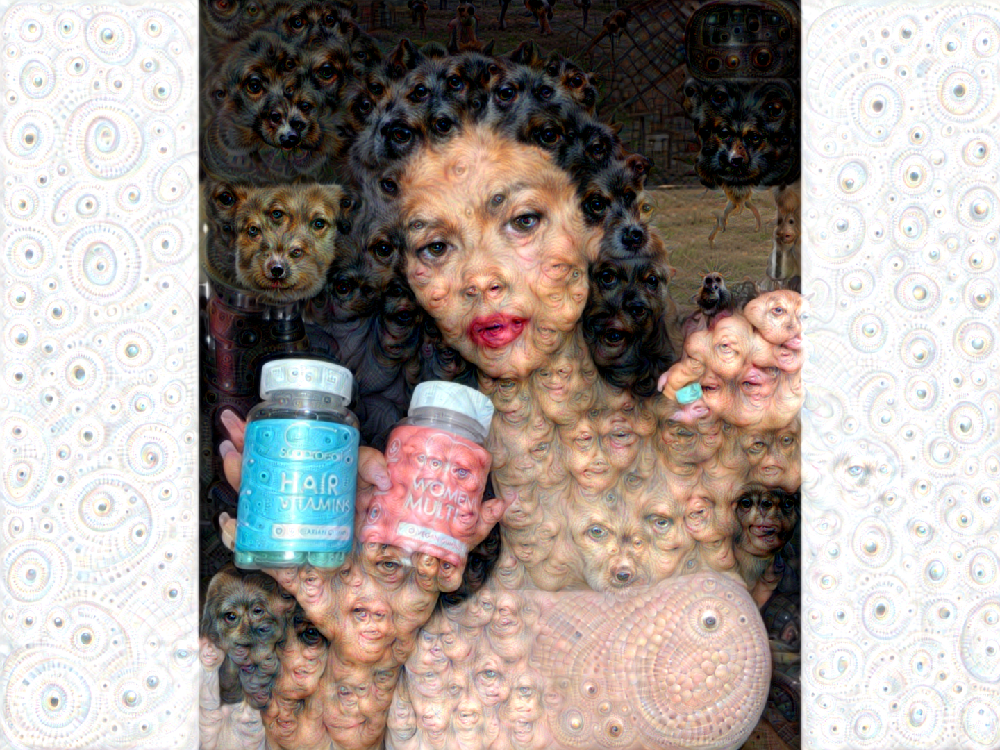

In [46]:
layer_tensor = model.layer_tensors[6]
img_result = recursive_optimize(layer_tensor=layer_tensor, image=image,
                 num_iterations=10, step_size=3.0, rescale_factor=0.7,
                 num_repeats=4, blend=0.2)

In [48]:
save_image(img_result, filename='deepdream_hulk.jpg')

Recursive level: 0
Image before:


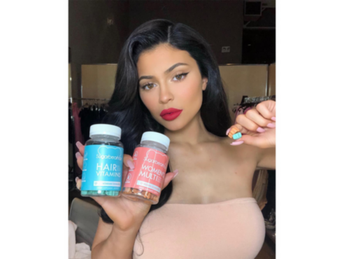

Processing image: . . . . . . . . . . 
Image after:


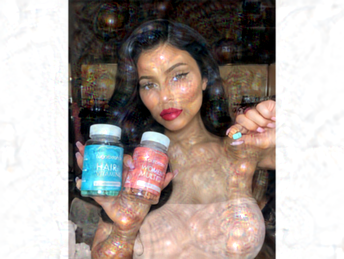

Recursive level: 1
Image before:


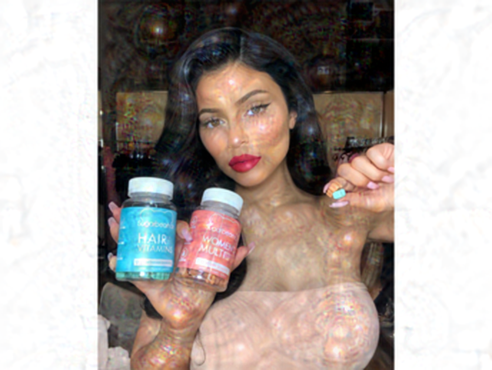

Processing image: . . . . . . . . . . 
Image after:


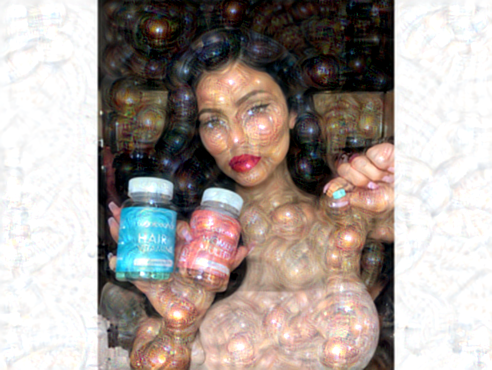

Recursive level: 2
Image before:


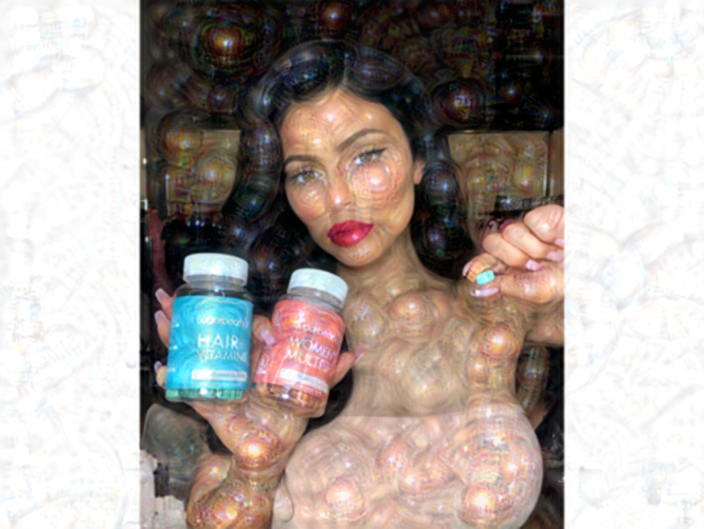

Processing image: . . . . . . . . . . 
Image after:


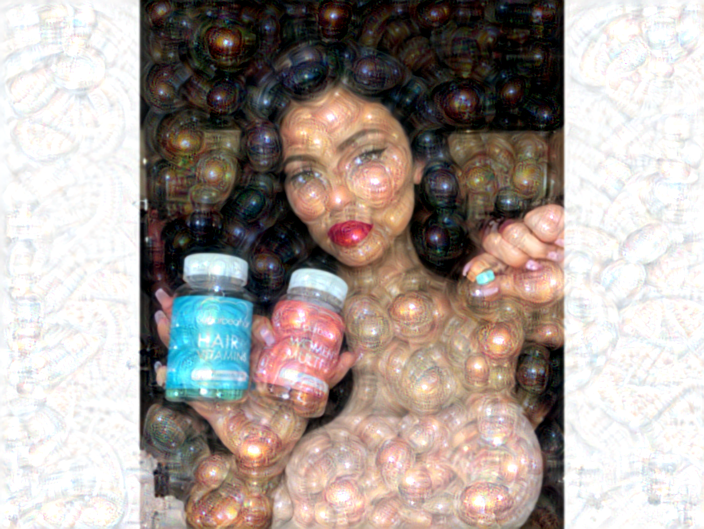

Recursive level: 3
Image before:


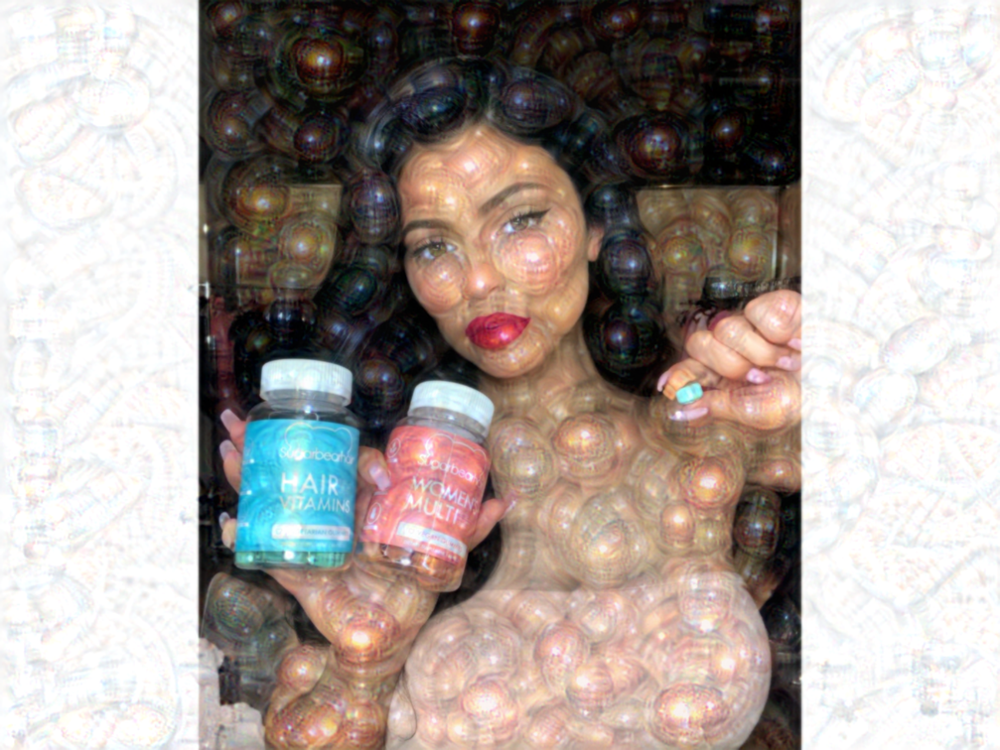

Processing image: . . . . . . . . . . 
Image after:


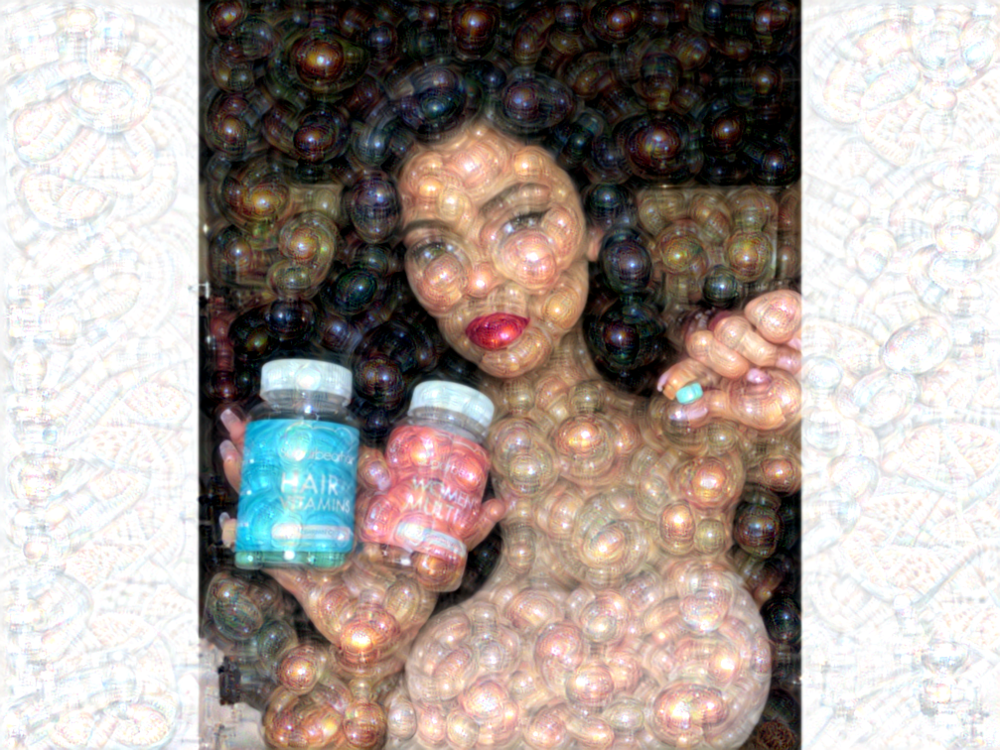

Recursive level: 4
Image before:


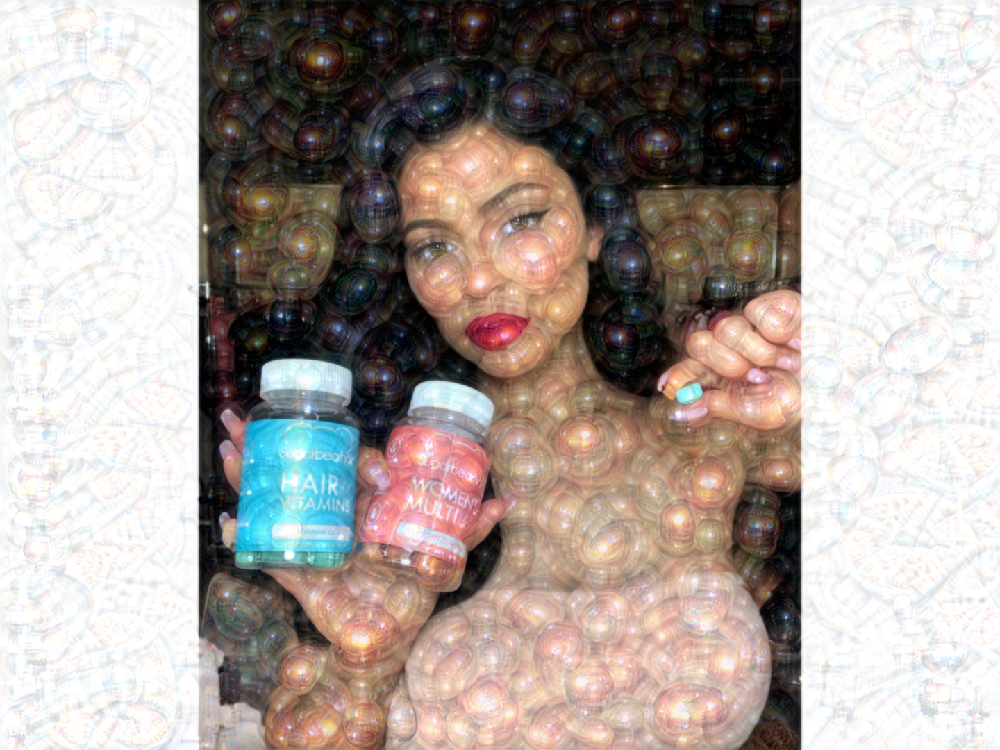

Processing image: . . . . . . . . . . 
Image after:


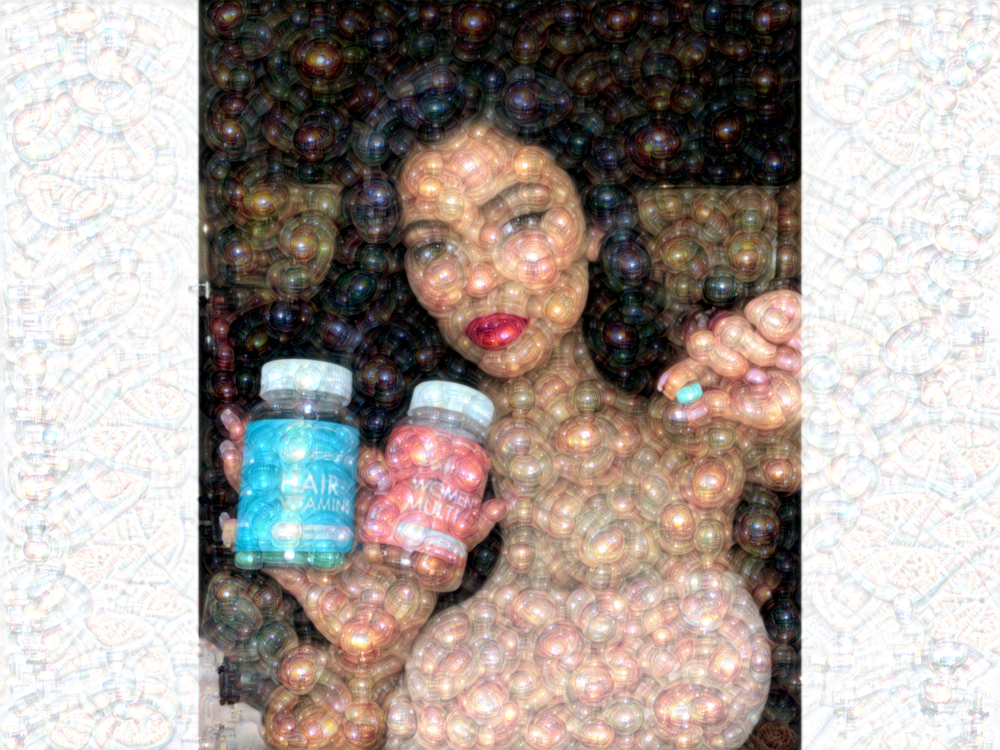

In [49]:
layer_tensor = model.layer_tensors[7][:,:,:,0:3]
img_result = recursive_optimize(layer_tensor=layer_tensor, image=image,
                 num_iterations=10, step_size=3.0, rescale_factor=0.7,
                 num_repeats=4, blend=0.2)